# 2) Metropolis algorithm

## a) Implementation

Markov-chain of random numbers $\{x_i\}_i$ with distribution $w(x)$:

1. From a random $x_i$, calculate the next potential random number $\bar{x}_{i+1}$:
    - choose a random $\delta\in[-1,1]$ (equally distributed)
    - calculate $\bar{x}_{i+1} = x_i + h\delta$
2. Calculate $\alpha = \frac{w(\bar x_{i+1})}{w(x_i)}$
3. Choose a random $\gamma\in[0,1]$ (equally distributed), then:
    - if $\alpha \geq \gamma$: accept new value, $x_{i+1} := \bar x_{i+1}$
    - if $\alpha < \gamma$: reject new value, $x_{i+1} = x_i$

In [1]:
## random number between a and b
# 0 ≤ rand() ≤ 1 → transform range
function rand_range(a,b)
    return abs(b-a) * rand() + a
end

rand_range (generic function with 1 method)

In [2]:
# generate a Markov chain from Metropolis algorithm
function markov_chain(
        x_start, # start value
        number_xs, # number of elements in chain
        h, # step size
        w # distribution of the values
    )
    # array to store the random numbers
    xs = zeros(number_xs)
    xs[1] = x_start
    
    for i in 1:(number_xs-1)
        # calculate next potential number
        δ = rand_range(-1,1)
        y = xs[i] + h*δ
        
        α = w(y)/w(xs[i]) # probability of acceptance
        γ = rand_range(0, 1)
        if α ≥ γ
            # accept new value
            xs[i+1] = y
        else
            # reject new value, keep current
            xs[i+1] = xs[i]
        end
    end
    return xs
end

markov_chain (generic function with 1 method)

In [3]:
# define the distribution
w(x) = 1/sqrt(π) * exp(-x^2)

# generate the markov chain
x_start = 0
number_xs = 1_000_000
step_size = 1
xs = markov_chain(x_start, number_xs, step_size, w);

To show, that the random values in the Markov chain are indeed distributed as given by $w(x)$, we only have to plot the histogram of $\{x_i\}_i$ (count of the values in specific intervals vs. value) and compare that with the given distribution:

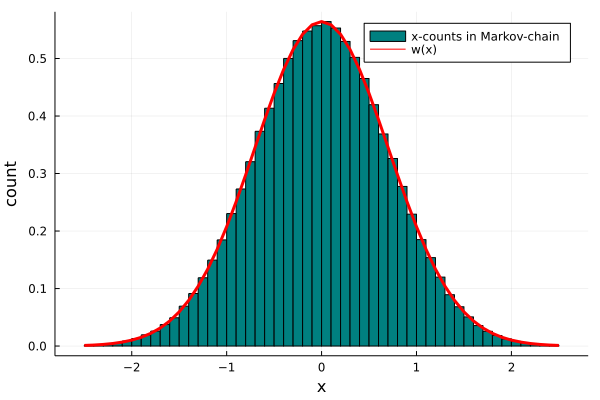

In [4]:
using Plots
histogram(xs; bins=-2.5:0.1:2.5, normalize=true, color="teal", label="x-counts in Markov-chain")
plot!(collect(-2.5:0.1:2.5), w.(collect(-2.5:0.1:2.5)), width=3, color="red", label="w(x)")
xlabel!("x")
ylabel!("count")
#title!("Comparison of the Markov-chain and the given distribution")

In [96]:
savefig("2a_markov.png")

## b) Markov without unchanged values

In [189]:
# variant 1:
# generate a Markov chain from Metropolis algorithm, 
# but don't copy the current value but instead try another value (!)
# ≃ rejection sampling algorithm
function markov_chain_rejection_sampling(
        x_start, # start value
        number_xs, # number of elements in chain
        h, # step size
        w # distribution of the values
    )
    # array to store the random numbers
    xs = zeros(number_xs)
    xs[1] = x_start
    i = 1
    while i ≤ number_xs-1
        # calculate next potential number
        δ = rand_range(-1,1)
        y = xs[i] + h*δ
        
        α = w(y)/w(xs[i]) # probability of acceptance
        γ = rand_range(0, 1)
        if α ≥ γ
            # accept new value
            xs[i+1] = y
            i += 1
        else
            # reject new value, try with the next one
            continue
        end
    end
    return xs
end

# variant 2:
# generate a Markov chain from Metropolis algorithm,
# but delete the rejected (unchanged) values (number of elements reduces)
function markov_chain_without_unchanged(
        x_start, # start value
        number_tries, # number of tries ≠ number of elements in chain
        h, # step size
        w # distribution of the values
    )
    # array to store the random numbers
    xs = Vector{Float64}() # empty array
    push!(xs, x_start) # push first element to array
    
    for i in 1:(number_tries-1)
        # calculate next potential number
        δ = rand_range(-1,1)
        y = xs[end] + h*δ # instead of x at index i, look at the last element
        
        α = w(y)/w(xs[end]) # probability of acceptance
        γ = rand_range(0, 1)
        if α ≥ γ
            # accept new value
            push!(xs, y)
        else
            # reject new value, but DON'T keep current (total possible number of elements reduces by 1)
            continue
        end
    end
    return xs
end

markov_chain_without_unchanged (generic function with 1 method)

In [193]:
xs2 = markov_chain_without_unchanged(x_start, 1_000_000, step_size, w);

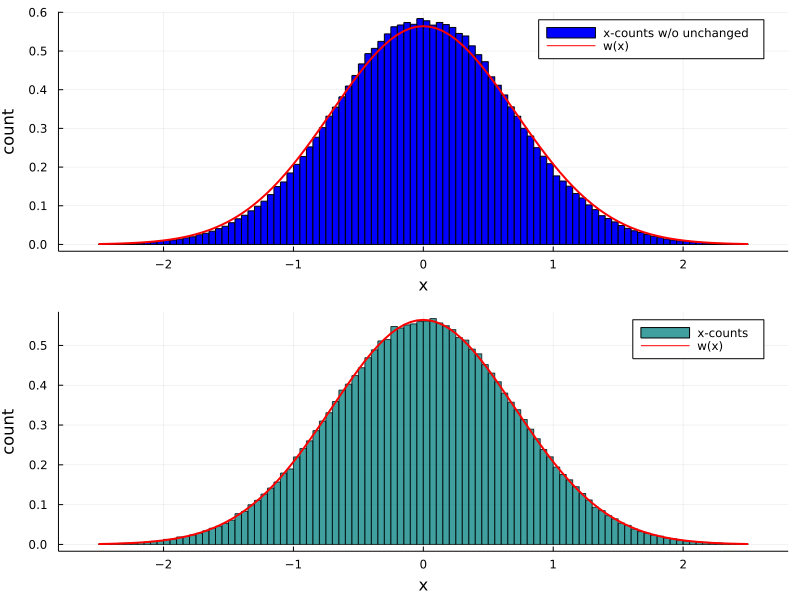

In [228]:
#using Plots
p1 = histogram(xs2; bins=-2.5:0.05:2.5, normalize=true, color="blue", label="x-counts w/o unchanged")
p2 = histogram(xs; bins=-2.5:0.05:2.5, normalize=true, color="teal", alpha=0.75, label="x-counts")
plot!(p1, collect(-2.5:0.05:2.5), w.(collect(-2.5:0.05:2.5)), width=2, color="red", label="w(x)")
plot!(p2, collect(-2.5:0.05:2.5), w.(collect(-2.5:0.05:2.5)), width=2, color="red", label="w(x)")

plot(p1,p2, size=(800,600), layout=@layout([a; b]))
xlabel!("x")
ylabel!("count")
#title!("Comparison of the Markov-chain and the given distribution"

In [229]:
savefig("2b_comparison_2.png")

### Comparison using different number of elements in the markov chain:

In [184]:
using Base64

In [185]:
l = @layout [a b]

1×2 Matrix{Any}:
 (label = :a, blank = false)  (label = :b, blank = false)

In [195]:
# animate for different number of elements (10,20,…,100,200,…,1000,2000,…,…,1000000)
anim = @animate for i in 1:5, j in 0:9
    xs = markov_chain(x_start, 10^i + j * 10^i, step_size, w)
    xs2 = markov_chain_without_unchanged(x_start, 10^i + j * 10^i, step_size, w)
    
    p1 = histogram(xs; bins=-2.5:0.05:2.5, normalize=true, color="teal", label="x-counts in Markov-chain")
    plot!(p1, collect(-2.5:0.05:2.5), w.(collect(-2.5:0.05:2.5)), width=3, color="red", label="w(x)")
    ylims!(p1, (0,0.7))
    title!(p1, "MC, n = " * string(10^i + j * 10^i))

    p2 = histogram(xs2; bins=-2.5:0.05:2.5, normalize=true, color="blue", label="x-counts in Markov-chain")
    plot!(p2, collect(-2.5:0.05:2.5), w.(collect(-2.5:0.05:2.5)), width=3, color="red", label="w(x)")
    ylims!(p2, (0,0.7))
    title!(p2, "MC w/o unchanged, n = " * string(10^i + j * 10^i))

    plot(p1, p2, layout=l, size=(1000, 400))
end

;

In [196]:
mp4(anim, "2b.mp4", fps=3)
gif(anim, "2b.gif", fps=3);

┌ Info: Saved animation to 
│   fn = /Users/felix/sciebo/MSc/2-Primary (SST_CMP)/Computational Many-Body Physics - SoSe 2022 (Core 1)/cmbp22-exercises/sheet_2/2b.mp4
└ @ Plots /Users/felix/.julia/packages/Plots/dNEbX/src/animation.jl:114
┌ Info: Saved animation to 
│   fn = /Users/felix/sciebo/MSc/2-Primary (SST_CMP)/Computational Many-Body Physics - SoSe 2022 (Core 1)/cmbp22-exercises/sheet_2/2b.gif
└ @ Plots /Users/felix/.julia/packages/Plots/dNEbX/src/animation.jl:114


In [197]:
display("text/html", """<video controls src="data:video/x-m4v;base64,$(base64encode(open("2b.mp4")))">""")
#display("text/html", """<img src="data:image/gif;base64,$(base64encode(open("2b.gif")))">""")

<video controls src="data:video/x-m4v;base64,AAAAIGZ0eXBpc29tAAACAGlzb21pc28yYXZjMW1wNDEAAAAIZnJlZQAE1oVtZGF0AAACoAYF//+c3EXpvebZSLeWLNgg2SPu73gyNjQgLSBjb3JlIDE2MyAtIEguMjY0L01QRUctNCBBVkMgY29kZWMgLSBDb3B5bGVmdCAyMDAzLTIwMjEgLSBodHRwOi8vd3d3LnZpZGVvbGFuLm9yZy94MjY0Lmh0bWwgLSBvcHRpb25zOiBjYWJhYz0xIHJlZj0zIGRlYmxvY2s9MTowOjAgYW5hbHlzZT0weDM6MHgxMTMgbWU9aGV4IHN1Ym1lPTcgcHN5PTEgcHN5X3JkPTEuMDA6MC4wMCBtaXhlZF9yZWY9MSBtZV9yYW5nZT0xNiBjaHJvbWFfbWU9MSB0cmVsbGlzPTEgOHg4ZGN0PTEgY3FtPTAgZGVhZHpvbmU9MjEsMTEgZmFzdF9wc2tpcD0xIGNocm9tYV9xcF9vZmZzZXQ9LTIgdGhyZWFkcz0xMiBsb29rYWhlYWRfdGhyZWFkcz0yIHNsaWNlZF90aHJlYWRzPTAgbnI9MCBkZWNpbWF0ZT0xIGludGVybGFjZWQ9MCBibHVyYXlfY29tcGF0PTAgY29uc3RyYWluZWRfaW50cmE9MCBiZnJhbWVzPTMgYl9weXJhbWlkPTIgYl9hZGFwdD0xIGJfYmlhcz0wIGRpcmVjdD0xIHdlaWdodGI9MSBvcGVuX2dvcD0wIHdlaWdodHA9MiBrZXlpbnQ9MjUwIGtleWludF9taW49MyBzY2VuZWN1dD00MCBpbnRyYV9yZWZyZXNoPTAgcmNfbG9va2FoZWFkPTQwIHJjPWNyZiBtYnRyZWU9MSBjcmY9MjMuMCBxY29tcD0wLjYwIHFwbWluPTAgcXBtYXg9NjkgcXBzdGVwPTQgaXBfcmF0aW89MS40MCBhcT0xOjEuMDAAgAAAWoFliIQAE//+97GPgU3IAA2XOop6H+EVsfSQUXqx2gvR5Yak2SWAA1FPeq/A5lxErr9qSnhgKm8Qil611HBVyNQPMY0d0ONi0aYPUAeVDeaD2sZAtsQr2s67tGMCg0NKLt7yIFFmL/eJ03/h01CFjmvX4nk9HRax/PgmMoq3Xpa/MzNY+UbTZ+eFzwHVN3wFiCLFTxfYheVEhVmTAq465MxIiKljCCbn41eAxyj9l+mPpMrXXIaglPpGCuaLFPMrXalc4glg1dXLLFgc0Dmc1e4JMvh7k5iWKn/cdO5TlOXqh9tNlqtRxQ2uZkUTrbCXQ1uyXrRIl5QofAHEDyJB09RtMbQH5GZh9SoS89x8aOg4enwXZ7JDMKDYqW0mln6ei75heBVr3x3B3UEq7NBdBTl1nWLVOgojBDLI/QsyYC8KlwSqsjbLRXPcEvzno6CEktdIUjq8ab/eWNk9oDR0tkyxy6v/Xq5ME9GOGrjmjmBPaT1AxoTmR7y+eLh5TDZVlkM+eI8o/UeOCoka9cbX1cv1MPcH83PIZ0OLpmXWQJqu9fs9gYPQi0DJwHk2tojPT+xSYXCY/tlt29WMlE85PVEQpObagPKVdQuWtPMb+pBOy/DFnBJw6Dts4sJG9sLwuQmmZJh0mMNjnf18RiWKznU1xzXqHryNwLWiMeJYpKQnCyrBqte66AZwyO4ZS/cm9LkzcLTLEapn/UeTdSBIi3R6WQWAKXGw8Saju5Cjx0LeI+dYhXpEbQ4wtUYKWgQeXCR2n+OIu1btduiDOOia5lYcM20idKUM+LtW+wOOO9kYW8R50AbZjSiADWqjlms7UgAi3CcqF+lcjT1chdWv8PYexo6vAQwX6vpfGuUVn/N7iRkfQwWz4nNsk3GuVrQKCDFJWa2wCuCcgKrvp75TkWL8hT7jVacrezqiFeRMQWsUQ7RPyMkdnfocRXm/48bp8bKSIJkCMODzby+MdFdsAsAZ5P7qxsGLBmZ8kNkak3yKp1Tl+dUWkwVxexTiIROLNIlTGL1jPAUhku9WryJjeravHV02TreILM0dNtUVLH7R93wlUE0mgKIp57t628G5KcThdds7YaNN0LD6nBaHwUq9EXALzB+dRfTdeY97No/koEl9GprqXLu63y5/2MsrkPE7Iranh4sOQWh0XZEu+eXOULsholaUqirABq8aSgIzIJK6fFiYXXQpPztsqVWwuRX0O1LeH1np2LlEanNb8UyZeZRxpuzOVGDGpHW3guaF0lVinlugO7Ij7qBpKXIWNYg3TaitdP3SMA8A2BtiXiQrxhrhoDV79VNmcQkyt3ED0VIAEQlwWFg0gq4bMk1DL+OnhhSsZpNMTlXFz7lOpb+QX8a+O/6UVJ/hOaxRMoTCdj8qGnq9YC2Z9zZTBu3Op41mW5nt33c2Tt4s4Yh3+EsxUgM5Ot//N7r3ytVCb8BnR98KuUzdHMTGVLX3sQTJW0nwmnhsV/j8UAf6hehyU8Dpo5RdE0aZSocJRShkbCXZNegVI/cnPZWB6v1YIO6nmRNakBsGVhTq5j2N6ByvlgRk01qTQFFVZavzZ2c/1xbay8TIPFnct2JbeCL/RoGpHbzoWmMHw/zIR4PGUdpFG3LOkaORsGxD9lD1lbVqUFkuuXn824zv+sUUk8ajILe79mwJUXA3bPA2xPOWiDQfea1bAivUChcm/HOWcBmWwo6AlDMraChN9iMt7VWLIQbLSXmGREaVLfxnOhlJdicuprfLyQG9fSzMerxr4/1eDbI7ngJYRKdQWUrStIoRG/qR0V4im4Yfd0ZY2QUVbtiSd6FlsNIrqlmXZWl6CuSjJ5U7+gRDL/WTXEqg6bhKfn6GMb8SPtVifjNt5uOL/bp4tlLpLH//u45pGK/13C9jmwWxqqIDddJVl3+YNNC2T1ezkXvC+quVvGx+ftQiDxiFss/kcm9Z94szx6UUz5ST8DQcP9uU9yj3ym5lYA8Evivo7/SIbAxlyfoxfHS0VtUYyJz8pKSV7lLnn3B+WY5NeSFNUUBrlCQNp0MEPmNrtb2lmHiBivbaGQbxY02ZTcmEaE5A+zLgSU8IYlZVvH+Gp3fgVHwl2KNh+3TaRpUh2kLQ7OA3xy5KUYq2RAFHZ+6jOmK864LxWf7W2oaVVw7zA9lKAnaTPBFf64fBB4n+7faYk8/qzfLx3lGMaELACfQD9y0FIoZ/zh6wqXGiWDTISWnlP/gxwdjBusGtH1vqapPvEy+6/k0AsxSHpW6wRQrJDyzvXsH72825M/QVu3zXZSgKh/Lv+dpOoWpSpMZybTtIA5oSxHhPqYwvuHocMknh2vZL1Q5OGsJQRqU7O72JiX/4e4gh39YRK4BQ8/uC6yu/SxP8xaHeqXPf21VkuX/ajQpGcbdJ7ES7V9ON9LyzwEVnic/LtzdHdstLc4IRmGFiQ8b2YKGvxACnrrZIFg+zGCn+YYzUGghwUMJ+wWx7vvguzVNUmsw++EamiIpZnbF2aB/79bfgZQVlPCuYI223GN0TPsMINBI5l+JCG6d7dWwyu4gVml9df+OP99j1NX4UMZDavJzq23WXSfAXzqbDeVhI7Yu539zAGtI9Cbr6jvtYgcLrjYTLBx+wt67f9hiXFnbVLOCCa3j2BPJuYhDz0rPwXOZMkWpAHI7GOwjgkRkIaq0g5MrDqCO8dUmTWMqga8BqO3NgXkUiSA+5ae3FIfCMid/OAp1BjrSJbMXvSO/MY1VU+h3ztNJ6VOicxMydkldoxmA0WZFL9yXqEteR3iBAtDqzH/Cxagi4UAq3va77Hr4sBXhF6ynb86wdtLBXu6OMYDeW3otSZZ0SfCZaE4Tofe4XHqtRfB1xf2TqS3wYYyzh5JPEdnnnvNdY/+XpD/aoWwVgRv7hPAPuNBI2Z83H5POfaQy9upaH6uPd5jv8G0vx86OSII7Mu+j5V8xZBpt+kiP5qK/70Ip9REb3X+6hfOtbTRpeWR03jI0/f9X

## Just for fun: visualization of the Metropolis algorithm

In [178]:
# generate a Markov chain from Metropolis algorithm
function markov_chain_visualized(
        x_start, # start value
        number_xs, # number of elements in chain
        h, # step size
        w # distribution of the values
    )
    # array to store the random numbers
    xs = zeros(number_xs)
    xs[1] = x_start
    
    anim = @animate for i in 1:(number_xs-1)
        # calculate next potential number
        δ = rand_range(-1,1)
        y = xs[i] + h*δ
        
        α = w(y)/w(xs[i]) # probability of acceptance
        γ = rand_range(0, 1)
        if α ≥ γ
            # accept new value
            xs[i+1] = y
        else
            # reject new value, keep current
            xs[i+1] = xs[i]
        end
        
        
        # animation
        ps = scatter(xs[1:i+1], size=(1000,150), linetype=:path)
        xlims!(ps, (1,number_xs))
        ylims!(ps, (-3,3))
        xlabel!(ps, "Iteration i")
        ylabel!(ps, "x_i")

        hs = histogram(xs[1:i+1], bins=-2.5:0.1:2.5, normalize=true, size=(1000, 600))
        plot!(hs, collect(-2.5:0.1:2.5), w.(collect(-2.5:0.1:2.5)), width=3, color="red", label="w(x)")
        ylims!(hs, (0,0.7))
        xlabel!(hs, "x")
        ylabel!(hs, "counts")
        plot(ps, hs, layout=@layout([a;b]), size=(1100, 800), left_margin=10*Plots.mm, right_margin=10*Plots.mm)
    end
    return xs, anim
end

markov_chain_visualized (generic function with 1 method)

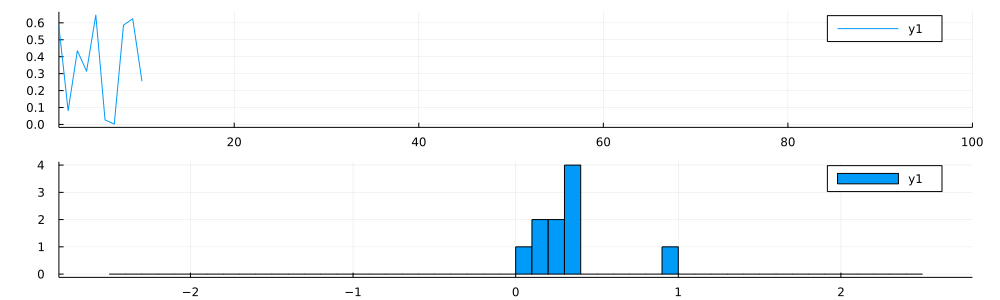

In [177]:
ps = scatter(rand(10), linetype=:path)
xlims!(ps, (1,100))

hs = histogram(rand(10), bins=-2.5:0.1:2.5, normalize=true)
plot(ps, hs, layout=@layout([a;b]), size=(1000, 300), left_margin=5*Plots.mm, right_margin=5*Plots.mm )

In [181]:
xs_v, anim_v = markov_chain_visualized(x_start, 10_000, step_size, w);

┌ Info: Saved animation to 
│   fn = /Users/felix/sciebo/MSc/2-Primary (SST_CMP)/Computational Many-Body Physics - SoSe 2022 (Core 1)/cmbp22-exercises/sheet_2/tmp.gif
└ @ Plots /Users/felix/.julia/packages/Plots/dNEbX/src/animation.jl:114


Plots.AnimatedGif("/Users/felix/sciebo/MSc/2-Primary (SST_CMP)/Computational Many-Body Physics - SoSe 2022 (Core 1)/cmbp22-exercises/sheet_2/tmp.gif")
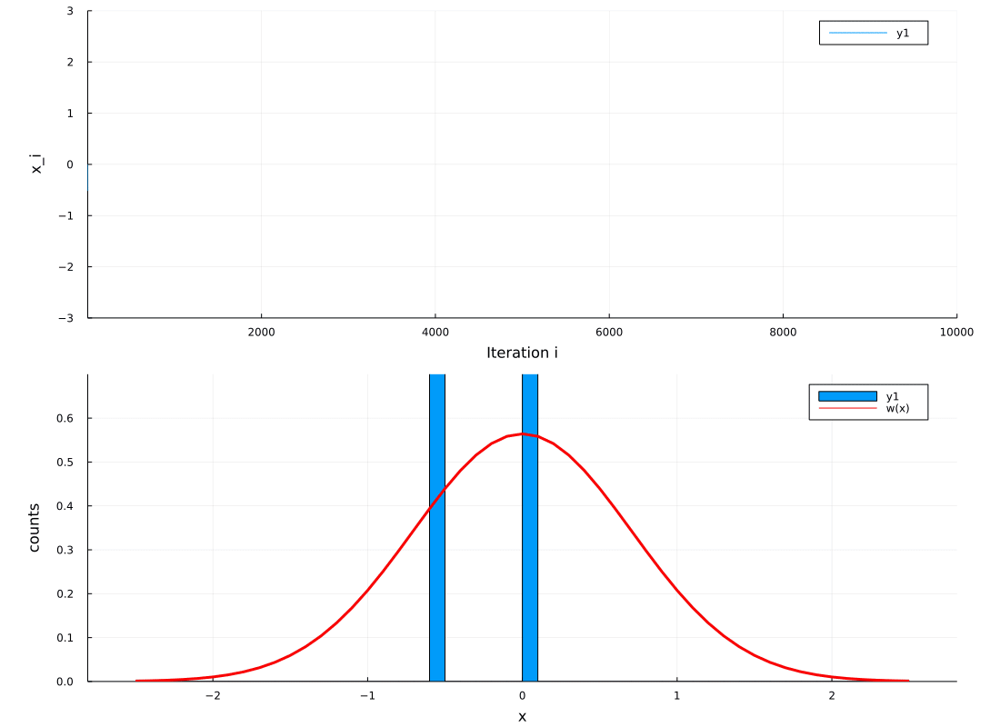

In [182]:
gif(anim_v, fps=60)